In [41]:
import collections
from itertools import chain, repeat
from functools import reduce

In [42]:
import numpy as np

import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from ipywidgets import interact, interactive, fixed
from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline

In [43]:
# Pipeline

# Distortion Correction 
# ===========================================================================
# Why?
#   - Distortion changes what the shape and size of the 
#     3D objects appear to be
#   - They change the apparent size, shape, appearance of the object in image.
#   - They make the objects closer or farther away.

# How?

In [44]:
chess_images = glob.glob("camera_cal/*.jpg")
print(len(chess_images))

20


# Look at chessboard - raw images

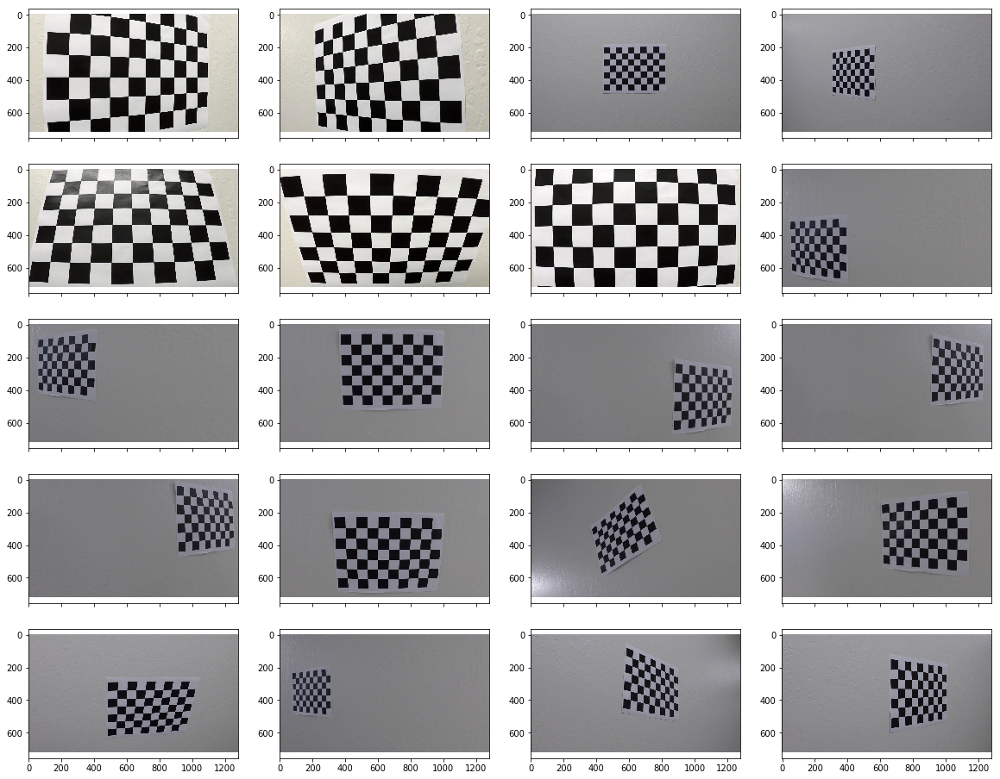

In [45]:
plt.rcParams['figure.figsize'] = (20.0, 16.0)
fig, axes = plt.subplots(nrows=5, ncols=4, sharex=True)

count = 0

for row in range(0, 5):
    for col in range(0, 4):
        axes[row, col].imshow(plt.imread(chess_images[count]))
        count += 1

In [46]:
# Reference - https://github.com/udacity/CarND-Camera-Calibration/blob/master/camera_calibration.ipynb

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
nx = 9 # number of inside chessboard corners in x
ny = 6 # number of inside chessboard corners in y

objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

objpoints = []
imgpoints = []

# Calibration

### Draw Corners | Calibration

In [47]:
def calibrate_image(img):
    nx = 9 # number of inside chessboard corners in x
    ny = 6 # number of inside chessboard corners in y

    img = plt.imread(img)   
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) # to gray   
    
    # Find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray_img, 
                                             (nx, ny), None)
    
    return img, (nx, ny), corners, ret

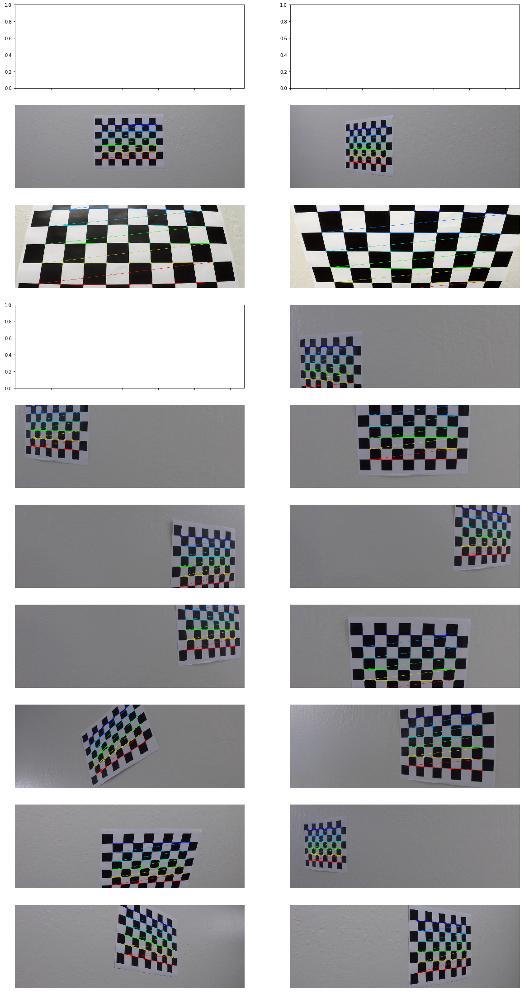

In [48]:
plt.rcParams['figure.figsize'] = (20.0, 40.0)
fig, axes = plt.subplots(nrows=10, ncols=2, sharex=True)
count = 0

# Calibration Stuff
for row in range(0, 10): # rows
    for col in range(0, 2): # cols
        
        img, (nx, ny), corners, ret = calibrate_image(chess_images[count])
        if ret: # if corners exist
            # add object points and image points
            objpoints.append(objp)
            imgpoints.append(corners)
            
            # draw the corners on the image
            cv2.drawChessboardCorners(img, 
                          (nx, ny),
                          corners,
                          ret
                         )
            
            axes[row, col].axis("off")
            axes[row, col].imshow(img)        
        count += 1   

### Undistort Images | Calibration

In [49]:
sample_chessboard_img = plt.imread(chess_images[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, 
                                                   imgpoints, 
                                                   (sample_chessboard_img.shape[1], sample_chessboard_img.shape[0]), 
                                                   None, 
                                                   None)

def undistort(img, mtx, dist):
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    return undistorted

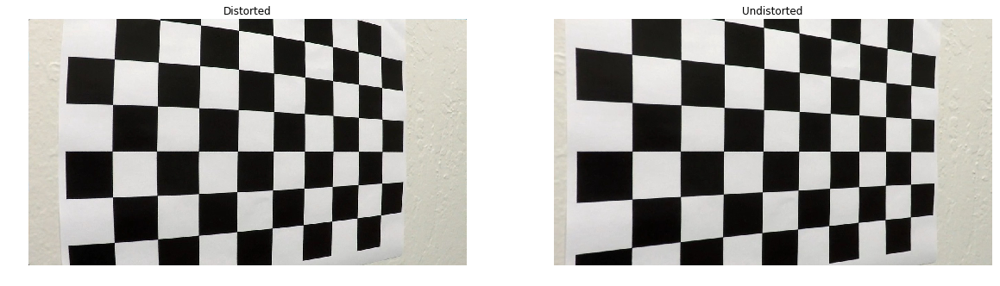

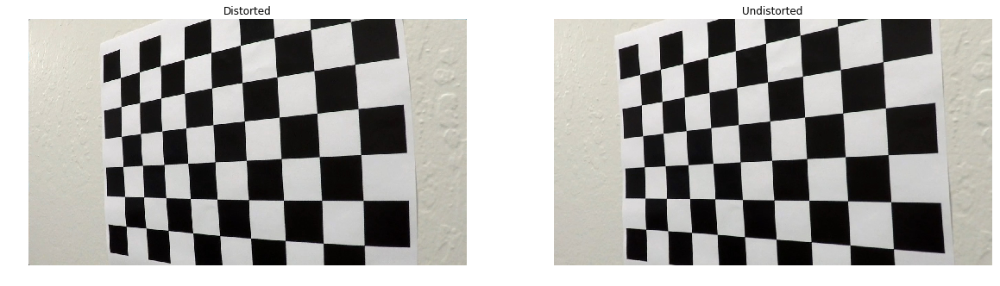

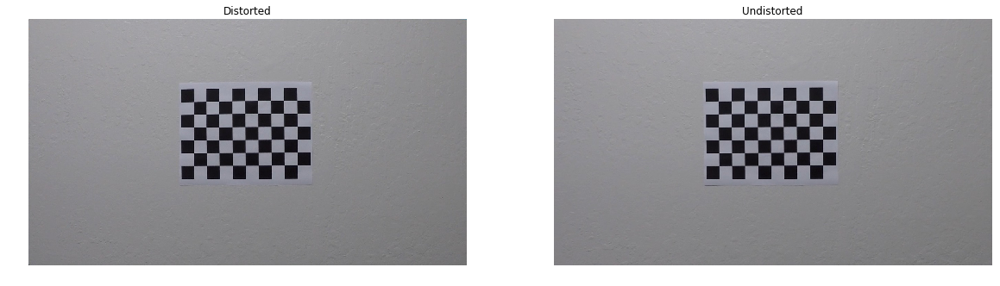

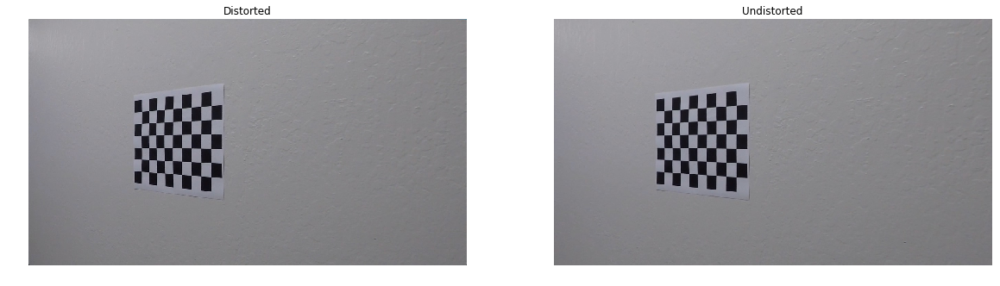

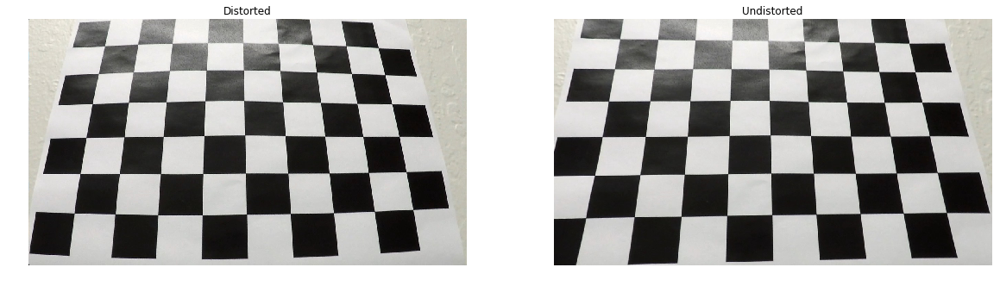

...

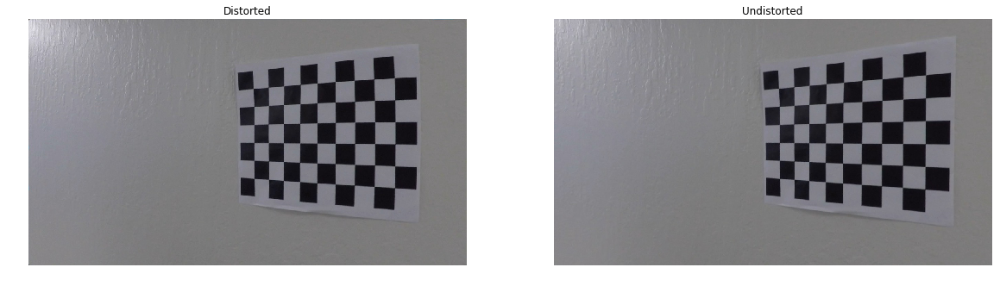

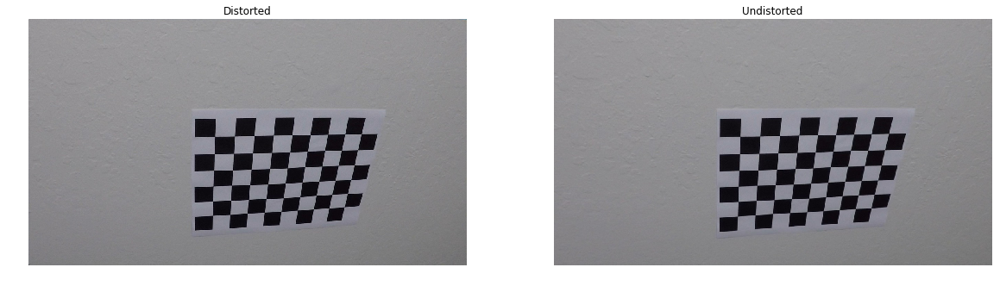

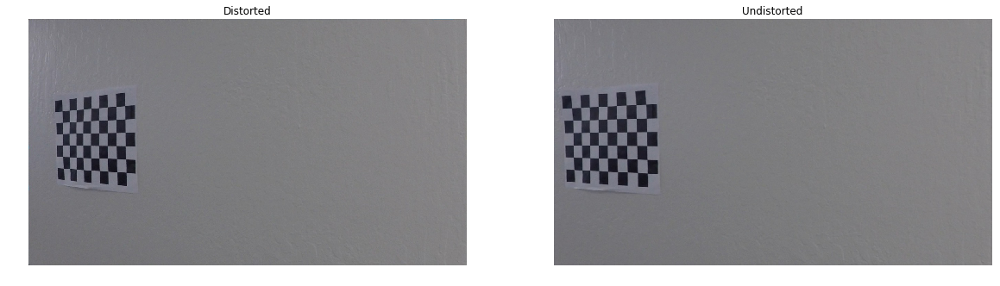

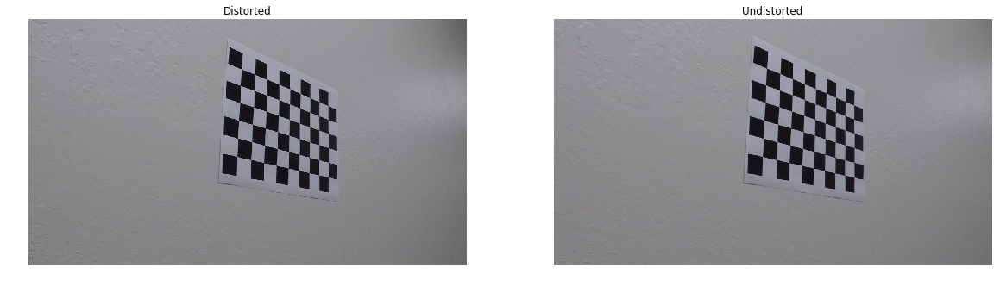

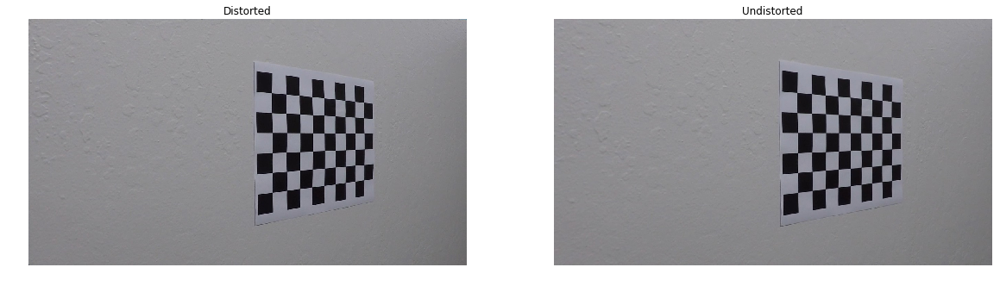

In [50]:
for img in chess_images:
    img = plt.imread(img)
    undistorted = undistort(img, mtx, dist)
    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Distorted")

    
    fig.add_subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(undistorted)
    plt.title("Undistorted")    
    
    plt.show()

### Undistort Test Images | Calibration

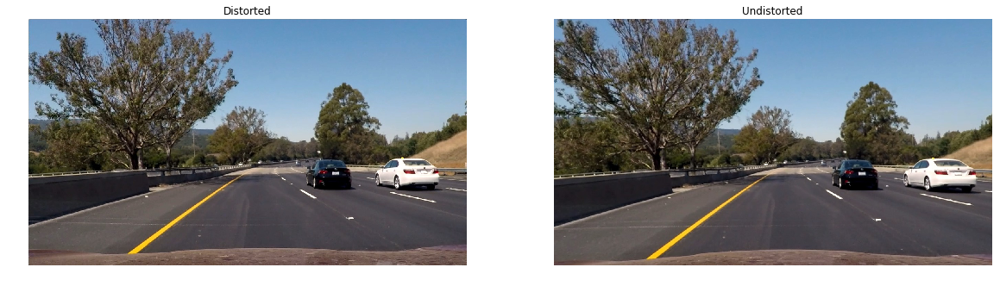

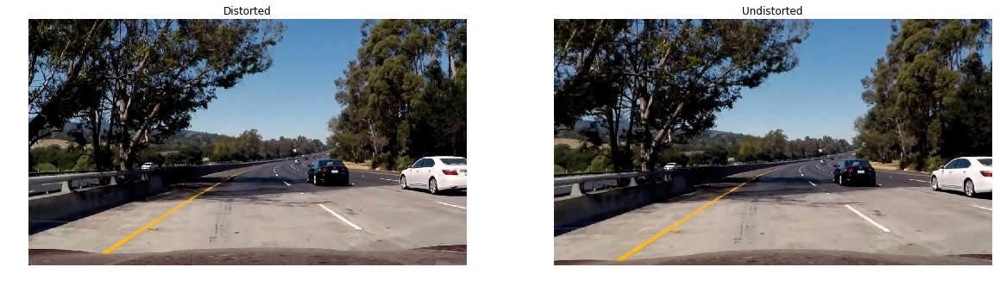

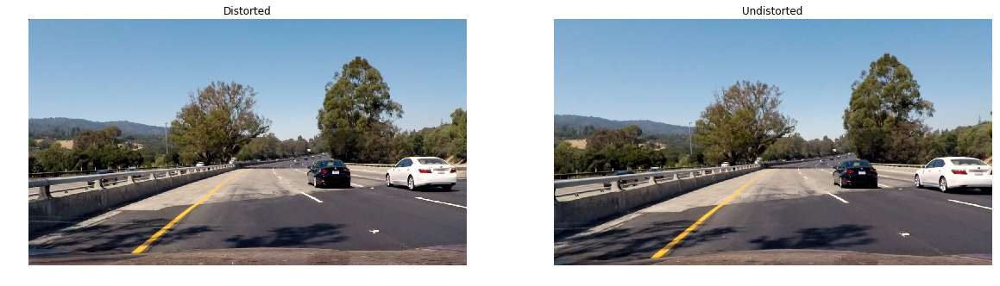

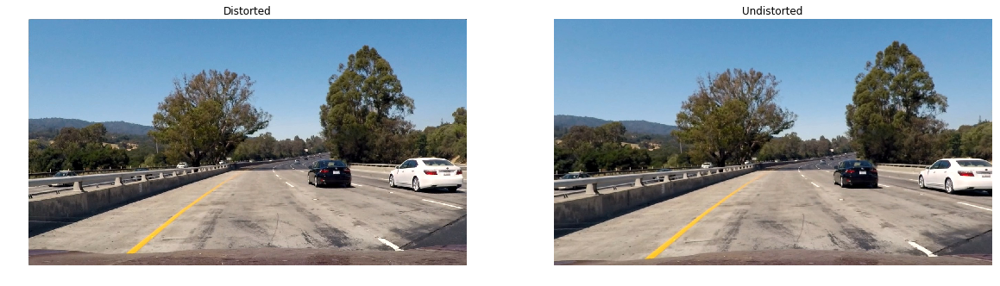

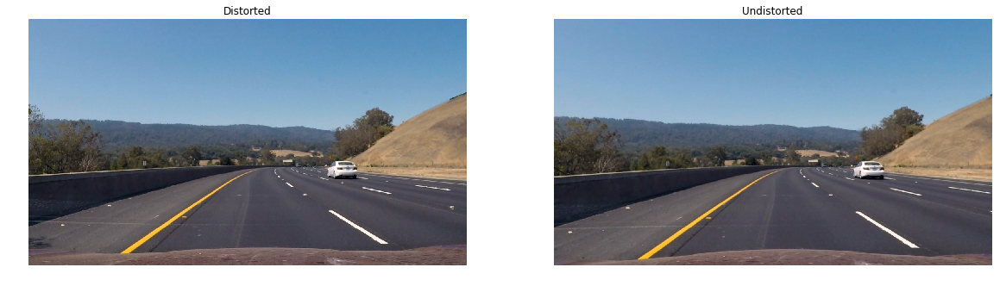

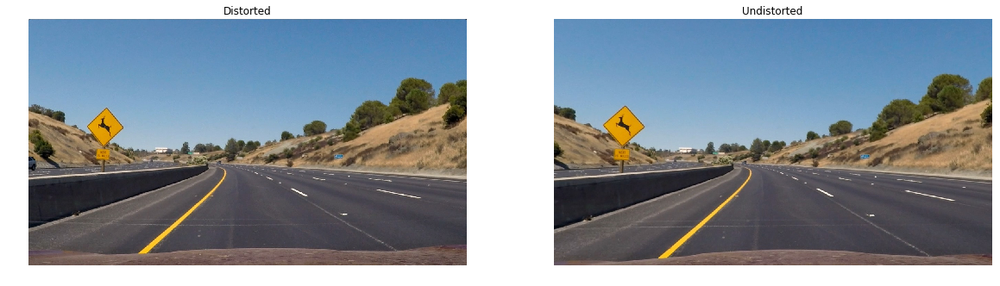

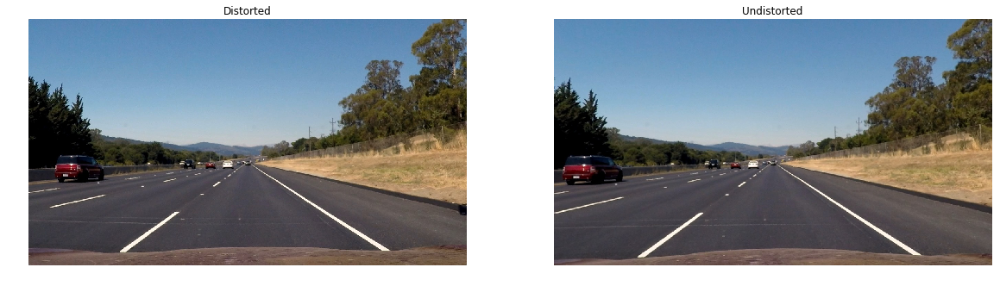

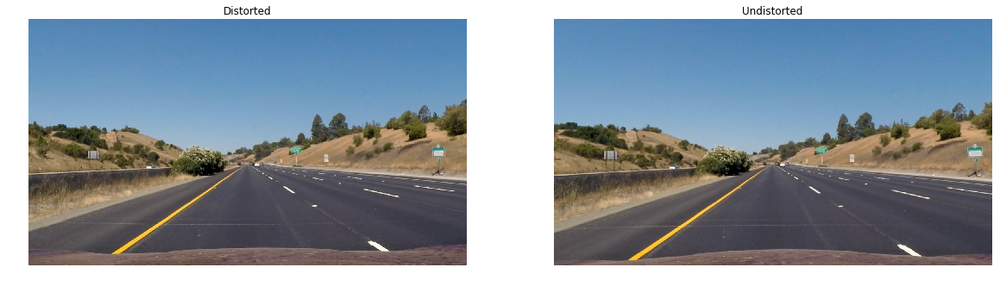

In [51]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)
    undistorted = undistort(img, mtx, dist)
    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Distorted")

    
    fig.add_subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(undistorted)
    plt.title("Undistorted")    
    
    plt.show()

# Binary Thresholding

### Sobel Threshold | Binary Thresholding

In [52]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    #Take the derivative in x or y given orientation
    if orient == "x":
        sobel_derivative = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == "y":
        sobel_derivative = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
     
    
    #Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel_derivative)
    #Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    #Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    #Return this mask as your binary_output image
    return sxbinary

### Magnitude of Gradient | Binary Thresholding

In [53]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    #Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    #Calculate the magnitude 
    magnitude = np.sqrt( (sobelx * sobelx) + (sobely * sobely) )
    
    #Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(magnitude)/255 
    gradmag = (magnitude/scale_factor).astype(np.uint8) 
    
    #Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1    
    
    #Return this mask as your binary_output image
    return binary_output

### Direction of Gradient | Binary Thresholding

In [54]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    #Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Take the gradient in x and y separately
    soblex = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobley = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    #Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(soblex)
    abs_sobely = np.absolute(sobley)
    
    #Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    gradient_direction = np.arctan2(abs_sobely, abs_sobelx)
    
    #Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(gradient_direction)
    binary_output[(gradient_direction >= thresh[0]) & (gradient_direction <= thresh[1])] = 1
    
    #Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

In [55]:
# dir_binary = dir_threshold(plt.imread(test_images[0]), sobel_kernel=15, thresh=(0.7, 1.3))
# # Plot the result
# f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
# f.tight_layout()
# ax1.imshow(plt.imread(test_images[0]))
# ax1.set_title('Original Image', fontsize=50)
# ax2.imshow(dir_binary, cmap='gray')
# ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
# plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Combine Absolute Sobel Thresh + Mag Thresh + Direction Thresh + S Channel | Binary Thresholding

In [56]:
def combine_all(img, kernel_size=3):
    
    # Compute the gradients in x & y direction
    gradient_x = abs_sobel_thresh(
        img,
        orient="x",
        sobel_kernel=kernel_size,
        thresh=(20, 100)
    )
    gradient_y = abs_sobel_thresh(
        img,
        orient="y",
        sobel_kernel=kernel_size,
        thresh=(20, 100)
    )
    
    # Compute the magnitude of Gradient | Binary
    magnitude_binary = mag_thresh(
        img,
        sobel_kernel=kernel_size,
        mag_thresh=(20,100)
    )
    
    # Compute the direction of Gradient | Binary
    gradient_binary = dir_threshold(
        img,
        sobel_kernel=kernel_size,
        thresh=(0.7, 1.4)
    )
    
    # Combine - Gradient & Magnitude & Direction
    combined = np.zeros_like(gradient_binary)
    combined[
        ((gradient_x == 1) & (gradient_y == 1)) |
        ((magnitude_binary == 1) & (gradient_binary == 1))
    ] = 1
    
    # Get HLS
#     img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S_channel = img_hls[:,:,2]
    
    # S channel threshold - Color Channel
    s_thresh = (150, 255)
    
    s_binary = np.zeros_like(S_channel)
    s_binary[
        (S_channel >= s_thresh[0]) &
        (S_channel <= s_thresh[1])
    ] = 1
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(combined)
    combined_binary[(s_binary == 1) | (combined == 1)] = 1
    
    
    return img, combined, s_binary, combined_binary

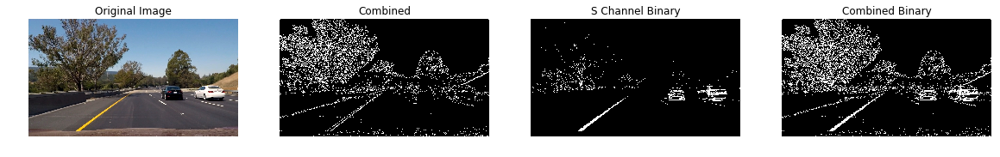

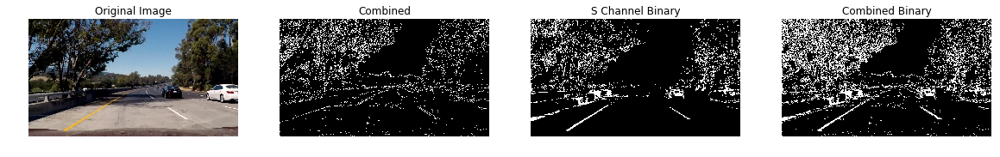

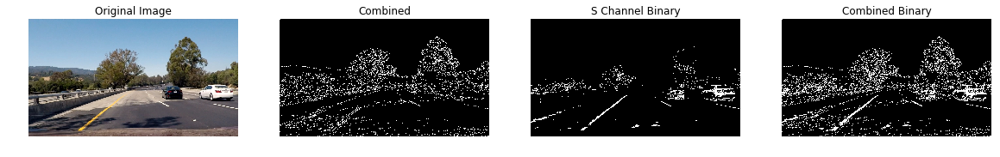

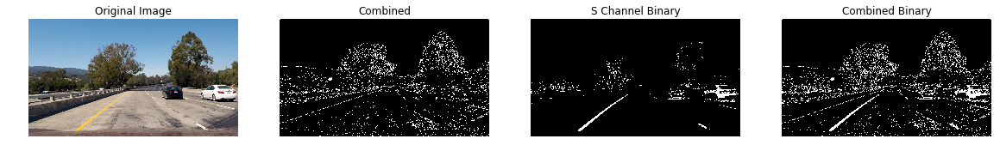

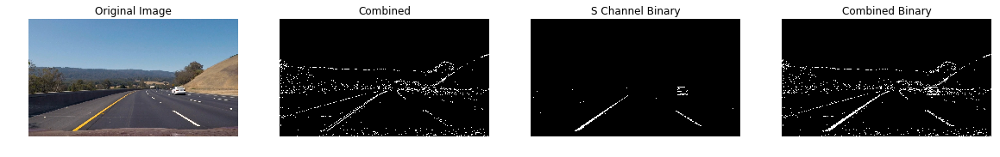

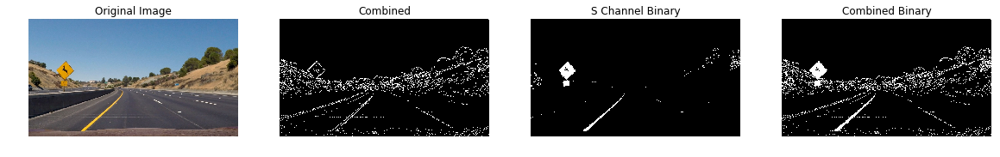

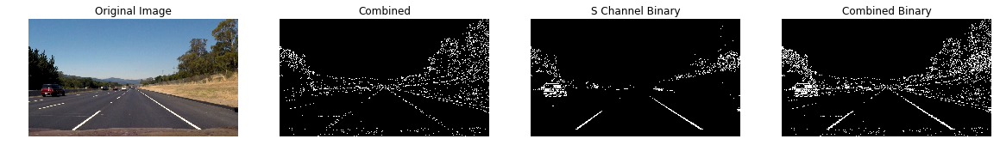

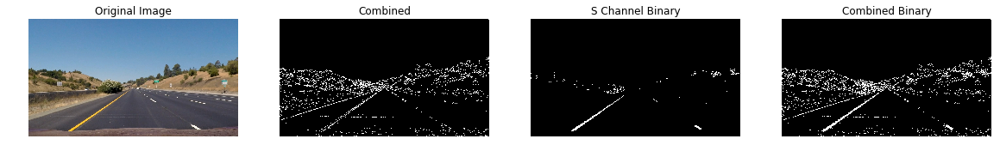

In [57]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)
    img, combined, s_binary, combined_binary = combine_all(img)
    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 4, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Original Image")

    
    fig.add_subplot(1, 4, 2)
    plt.axis("off")
    plt.imshow(combined, cmap="gray")
    plt.title("Combined") 
    
    fig.add_subplot(1, 4, 3)
    plt.axis("off")
    plt.imshow(s_binary, cmap="gray")
    plt.title("S Channel Binary") 
    
    fig.add_subplot(1, 4, 4)
    plt.axis("off")
    plt.imshow(combined_binary, cmap="gray")
    plt.title("Combined Binary") 
    
    
    
    plt.show()

# Perspective Transform

In [58]:
def perspective_transform(img):#, nx, ny):

    
    img_size = (img.shape[1], img.shape[0])
    
    corner_left_up = [568, 470]
    corner_right_up = [717, 470]
    corner_left_low = [260, 680]
    corner_right_low = [1043, 680]
    
    corners = [corner_left_up,
               corner_left_low,
               corner_right_up,
               corner_right_low]
    
#     corner_left_up_new = np.array([corners[0, 0], 0])
#     corner_right_up_new = np.array([corners[3, 0], 0])

    # Offset for dst points
    offset = 100
    src = np.float32(corners)

    dst = np.float32([
            [200, 0], 
            [200, 680],
            [1000, 0],
            [1000, 680]
        
        ])
    
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)
    return warped, M, Minv

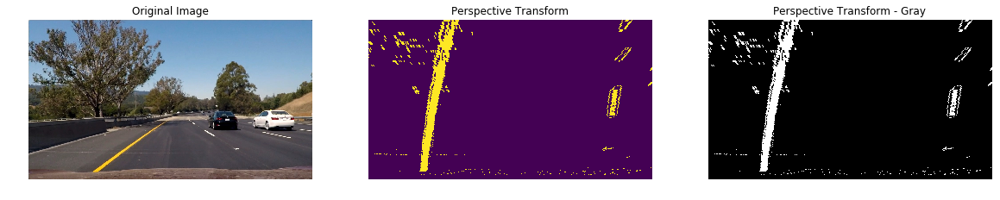

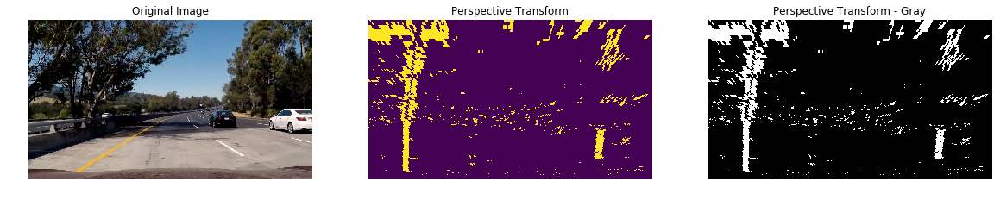

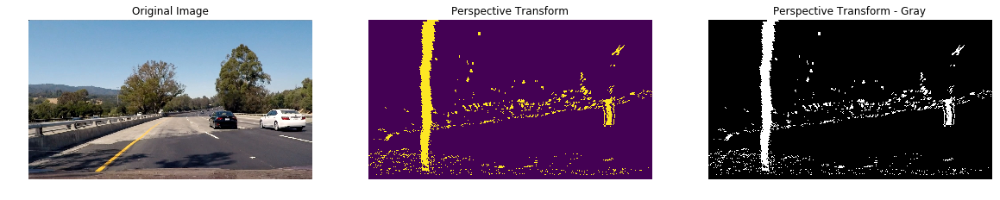

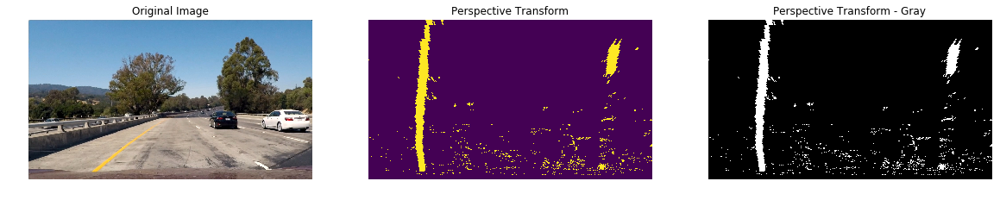

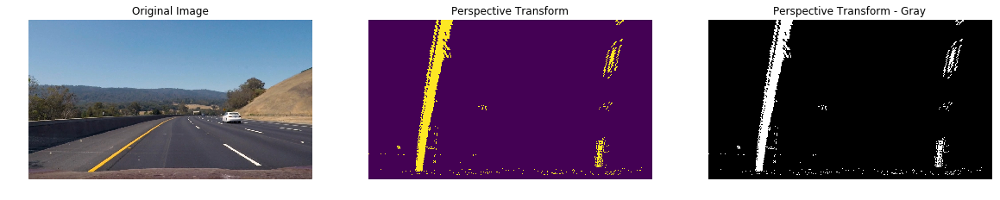

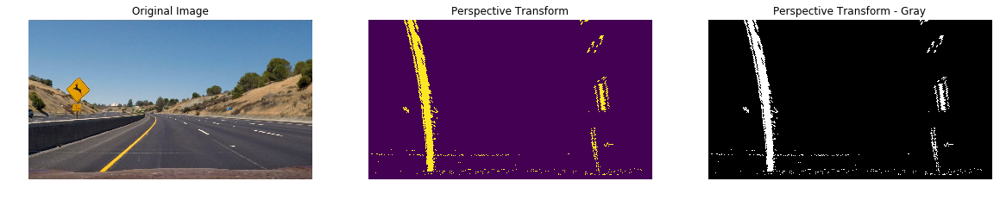

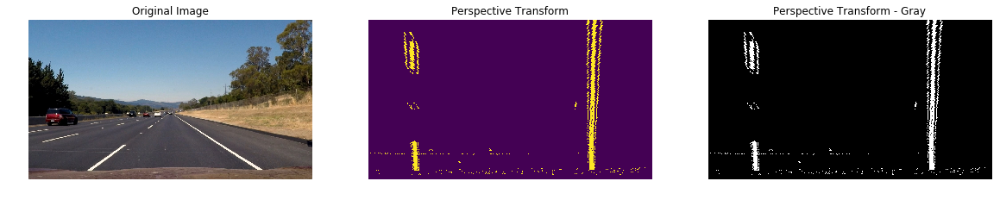

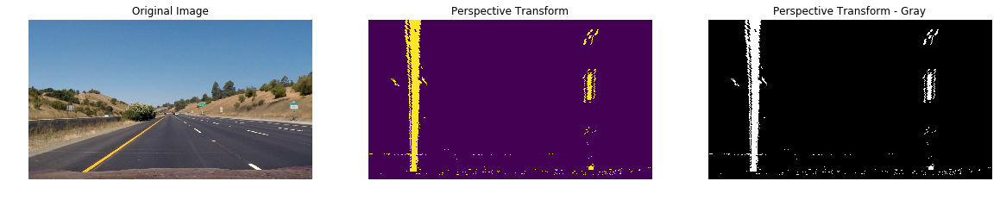

In [59]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)
    img, combined, s_binary, combined_binary = combine_all(img)
    
    warped_img, M, Minv = perspective_transform(combined_binary)#, nx, ny)
    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 3, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Original Image")

    fig.add_subplot(1, 3, 2)
    plt.axis("off")
    plt.imshow(warped_img)
    plt.title("Perspective Transform") 
    
    fig.add_subplot(1, 3, 3)
    plt.axis("off")
    plt.imshow(warped_img, cmap="gray")
    plt.title("Perspective Transform - Gray") 
    
    plt.show()

# Finding Lane Lines

### Finding Lane Lines | Sliding Window

In [60]:
def find_lane_pixels(binary_warped):
    """
    Sliding window polyfit
    """
    
    nwindows = 9
    margin = 100
    minpix = 50

    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(
            out_img,
            (win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),
            (0,255,0), 2) 
        cv2.rectangle(
            out_img,
            (win_xright_low,win_y_low),
            (win_xright_high,win_y_high),
            (0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass    
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit second order polynomial 
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds

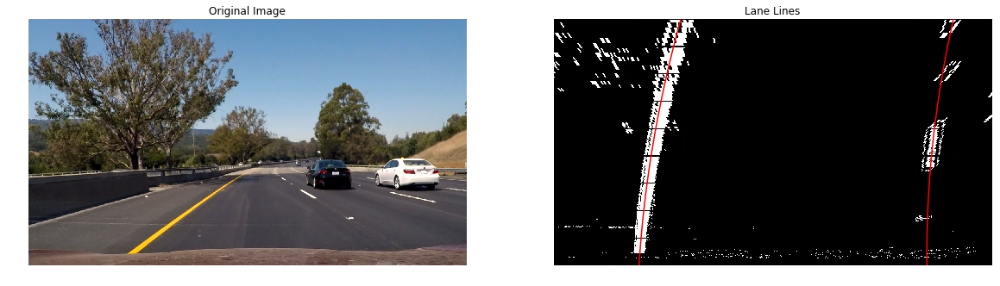

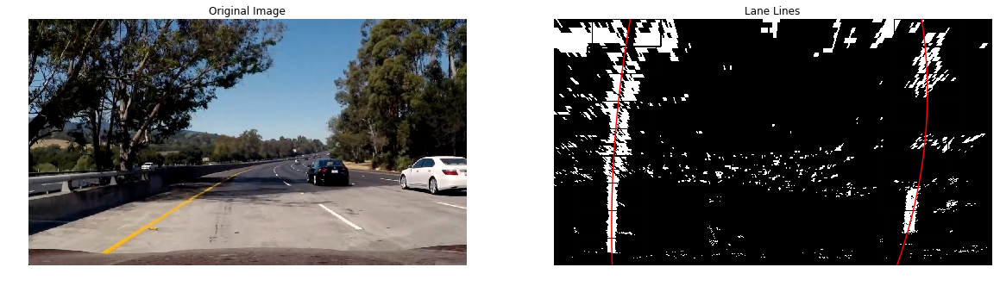

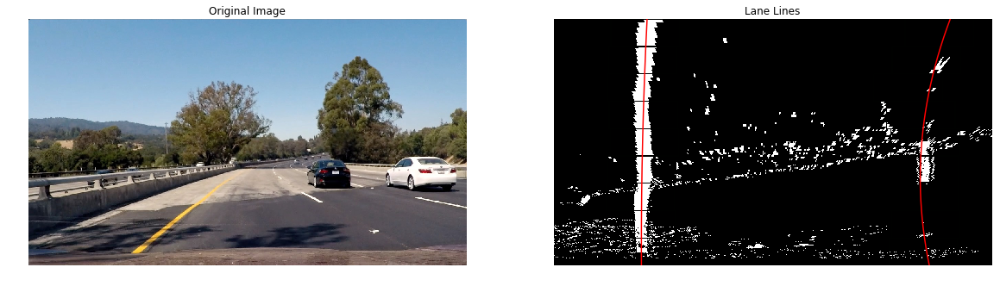

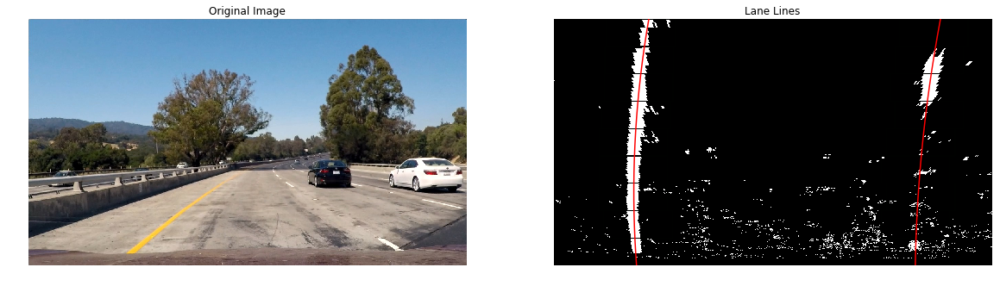

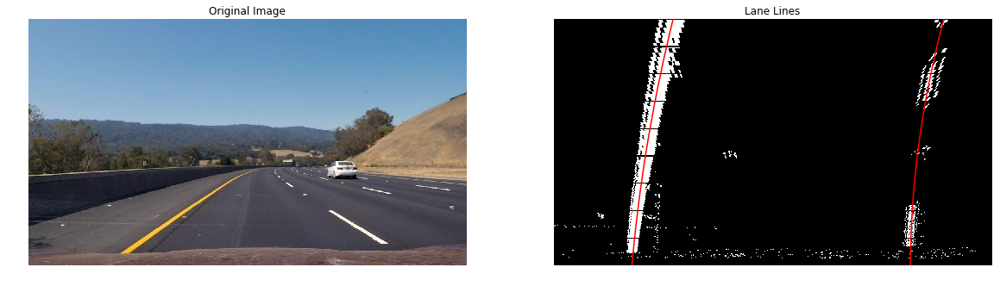

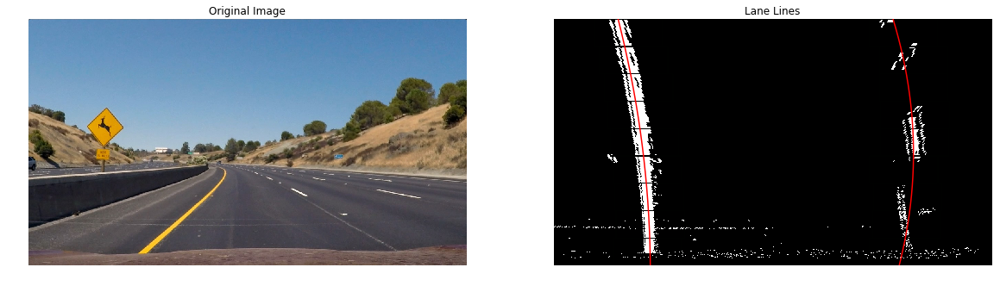

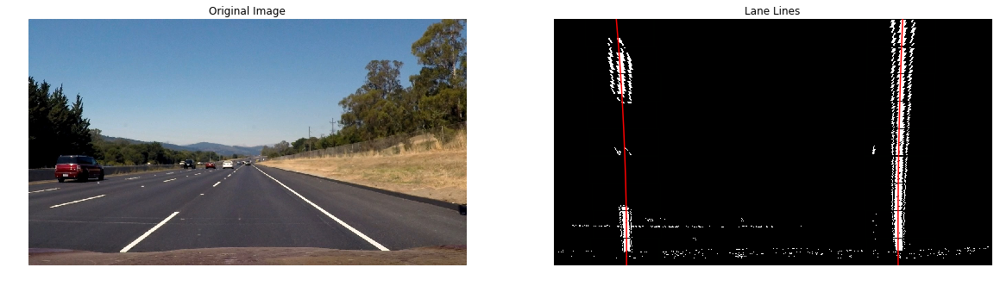

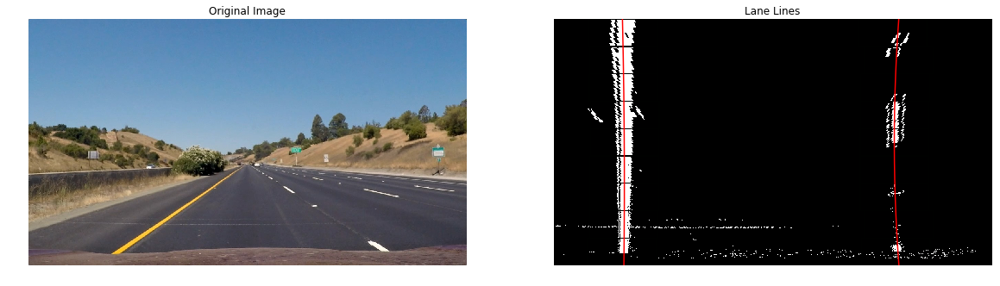

In [61]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)
    img, combined, s_binary, combined_binary = combine_all(img)
    
    warped_img, M, Minv = perspective_transform(combined_binary)#, nx, ny)
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
        find_lane_pixels(warped_img)
    
    # Generate data for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2] # xintercept
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] # xintercept


    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Original Image")

    fig.add_subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color="red")
    plt.plot(right_fitx, ploty, color="red")
    plt.title("Lane Lines") 
    
    plt.show()

### Finding the Lines | Search from Prior

In [62]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty


def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)


    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result, left_fitx, right_fitx, ploty, left_lane_inds, right_lane_inds

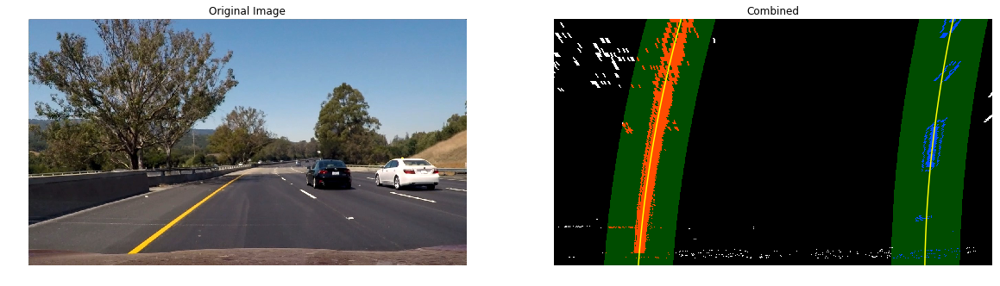

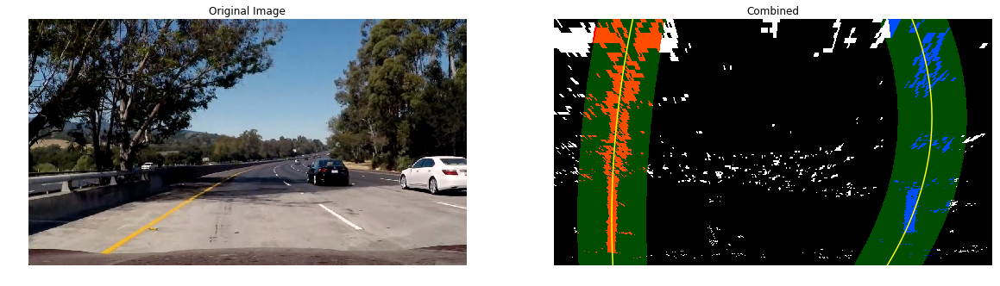

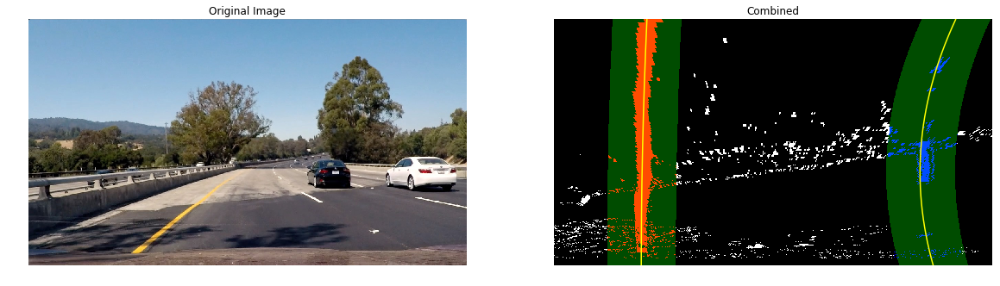

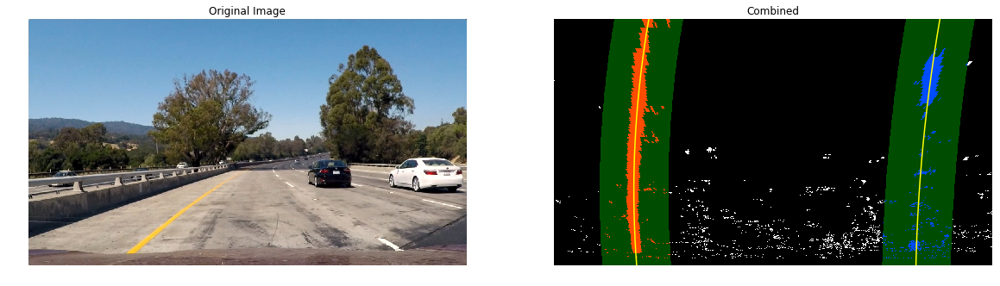

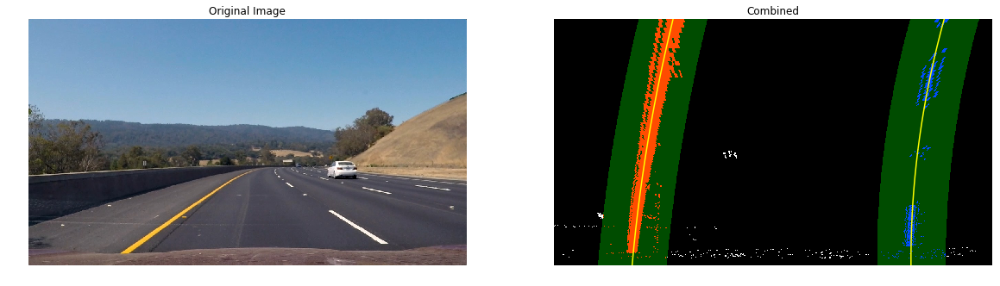

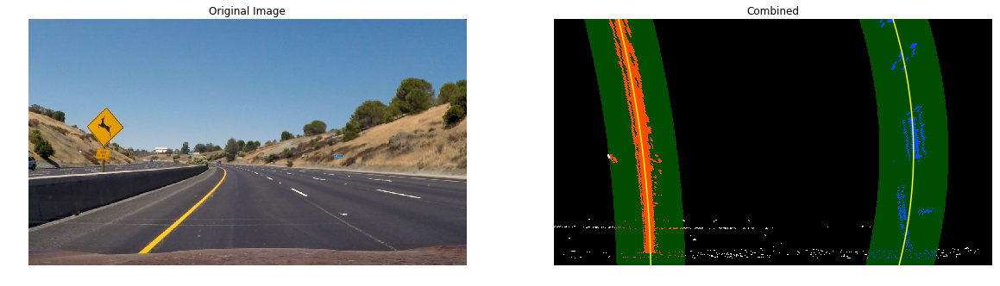

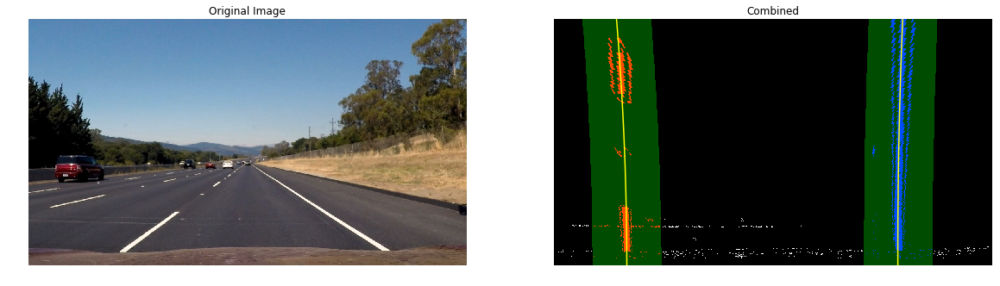

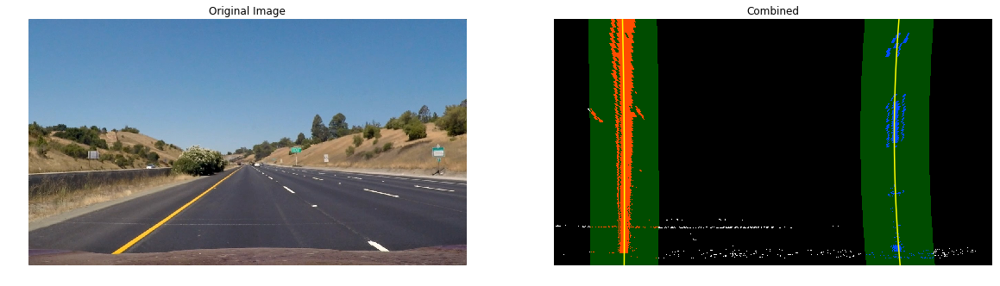

In [63]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)
    
    img, combined, s_binary, combined_binary = combine_all(img)
    
    warped_img, M, Minv = perspective_transform(combined_binary)#, nx, ny)
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
        find_lane_pixels(warped_img)
    result, left_fitx, right_fitx, ploty, left_lane_inds, right_lane_inds = search_around_poly(warped_img, left_fit, right_fit)

    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Original Image")

    fig.add_subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.title("Combined") 

# Radius of Curvature & Position of Vehicle with respect to Center

In [64]:
midpoints = []

for img in test_images:
    img = plt.imread(img)
    
    midpoints.append(img.shape[1] // 2)
    
    
print(midpoints)
print(np.mean(midpoints))

[640, 640, 640, 640, 640, 640, 640, 640]
640.0


In [65]:
def measure_curvature_real(binary_warped, left_fit, right_fit):
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    y_eval = np.max(ploty)
    
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty * ym_per_pix, left_fitx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)
    
    # New radii of curvature
    left_curvature =  ((1 + (2*left_fit_cr[0] * y_eval* ym_per_pix + left_fit_cr[1])**2) **1.5) \
                        / np.absolute(2*left_fit_cr[0])
    right_curvature = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) \
                        / np.absolute(2*right_fit_cr[0])
    
    # Vehicle center
    left_lane_bottom = (left_fit[0] * y_eval)**2 + \
                       (left_fit[0] * y_eval) + left_fit[2]
    right_lane_bottom = (right_fit[0] * y_eval)**2 + \
                        (right_fit[0] * y_eval) + right_fit[2]
    
    # Lane center
    lane_center = (left_lane_bottom + right_lane_bottom) / 2
    midpoint = np.int(binary_warped.shape[1] // 2)
    # Compute the center and convert to metres
    center = (lane_center - midpoint) * xm_per_pix 
    
    if center < 0:
        position = "left"
    else:
        position = "right"
        
        
    
    return left_curvature, right_curvature, center, position, ploty, left_fitx, right_fitx

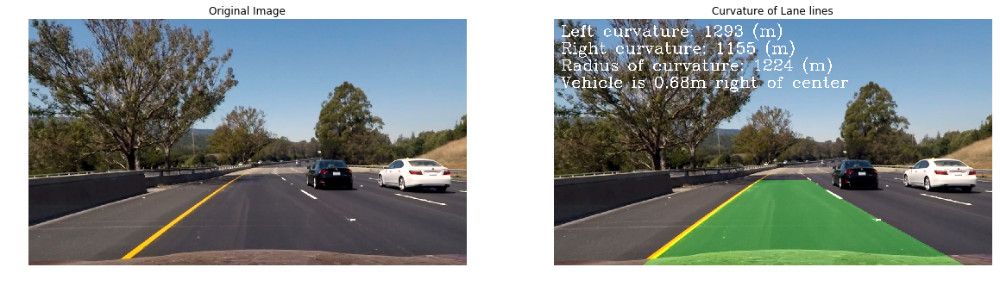

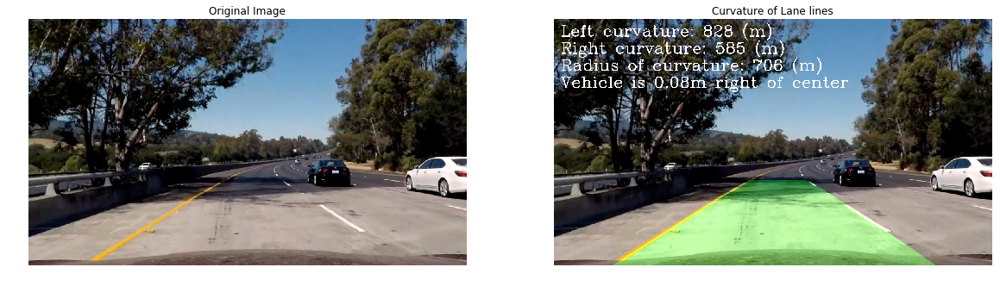

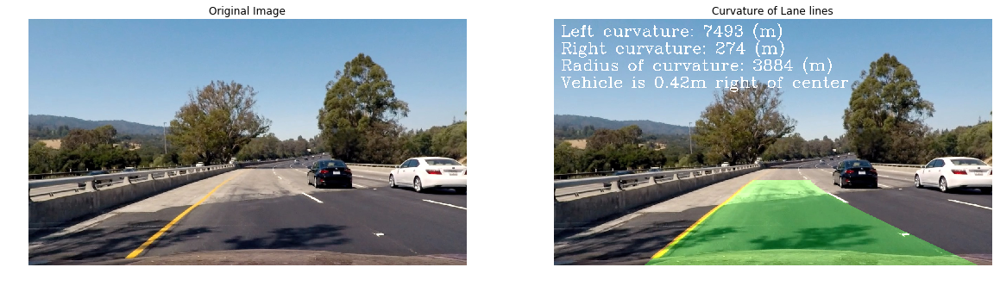

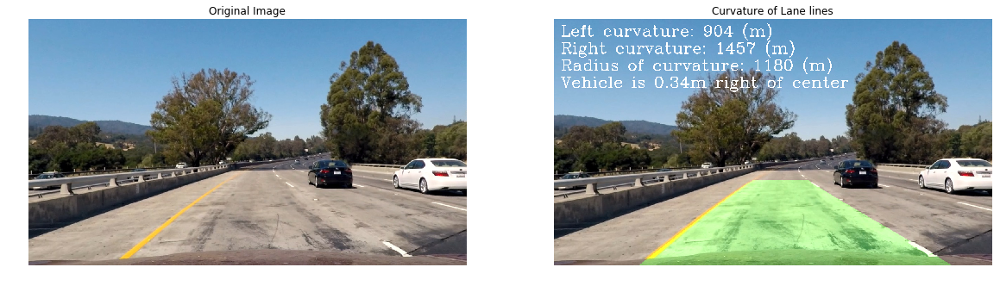

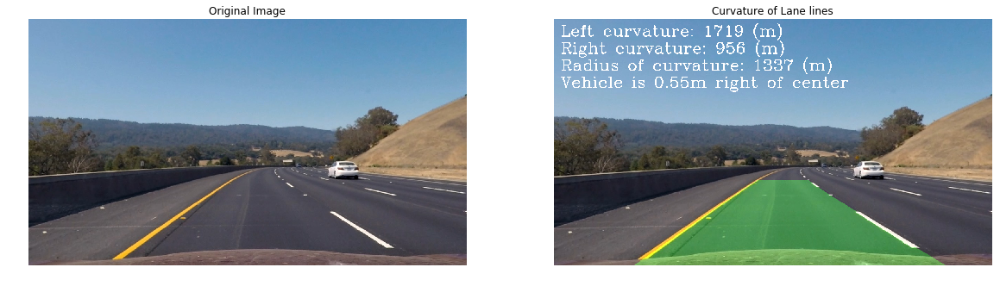

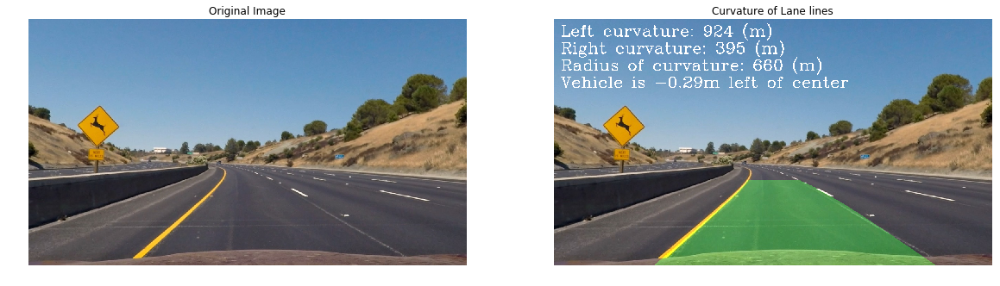

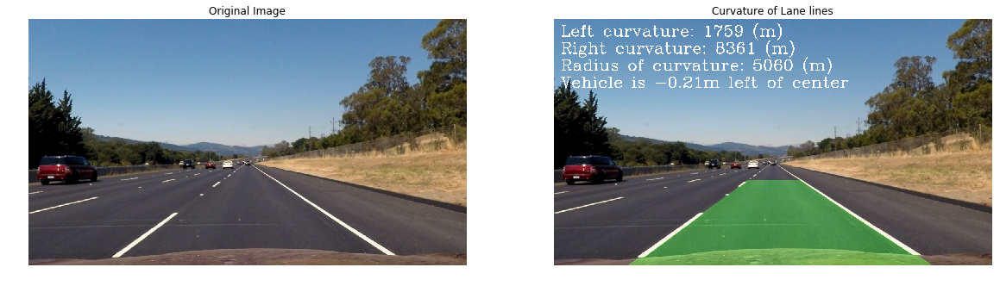

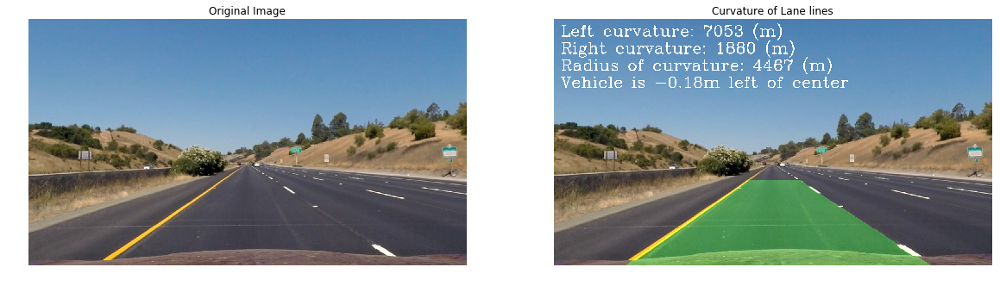

In [66]:
test_images = glob.glob("test_images/*.jpg")

for img in test_images:
    img = plt.imread(img)

    # Undistort Image
    undistorted = undistort(img, mtx, dist)
    
    img, combined, s_binary, combined_binary = combine_all(undistorted)
    
    warped_img, M, Minv = perspective_transform(combined_binary)#, nx, ny)
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
        find_lane_pixels(warped_img)
    left_curvature, right_curvature, center, position, ploty, left_fitx, right_fitx = measure_curvature_real(warped_img, left_fit, right_fit)
    
    # Create empty image to draw
    warped_binary = np.zeros_like(warped_img).astype(np.uint8)
    out_img = np.dstack((warped_binary, warped_binary, warped_binary))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    left_fitx_new = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_fitx_new = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    fitx = np.hstack((left_fitx_new, right_fitx_new))
    
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(out_img, np.int_([fitx]), (0,255, 0)) 
    
    warped_binary_new = cv2.warpPerspective(out_img, 
                                            np.linalg.inv(M), 
                                            (img.shape[1],img.shape[0])
                                            )
    # combine original and new warped image
    result = cv2.addWeighted(img, 1, warped_binary_new, 0.3, 0)
    
    cv2.putText(result, 'Left curvature: {:.0f} (m)'.format(left_curvature), (20, 50), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, 'Right curvature: {:.0f} (m)'.format(right_curvature), (20, 100), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, "Radius of curvature: {:.0f} (m)".format((left_curvature + right_curvature) / 2.0), (20, 150), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, '{}'.format("Vehicle is {:.2f}m {} of center".format(center, position)), (20, 200), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    
    plt.rcParams['figure.figsize'] = (20.0, 30.0)
    fig = plt.figure()
    
    fig.add_subplot(1, 2, 1)
    plt.axis("off")
    plt.imshow(img)
    plt.title("Original Image")

    fig.add_subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(result)
    plt.title("Curvature of Lane lines") 

In [67]:
# def image_pipeline(img):
    
#     # 

# Pipeline Video

In [68]:
# # Define a class to receive the characteristics of each line detection
# class Line():
#     def __init__(self):
#         # was the line detected in the last iteration?
#         self.detected = False  
#         # x values of the last n fits of the line
#         self.recent_xfitted = [] 
#         #average x values of the fitted line over the last n iterations
#         self.bestx = None     
#         #polynomial coefficients averaged over the last n iterations
#         self.best_fit = None  
#         #polynomial coefficients for the most recent fit
#         self.current_fit = []  
#         #radius of curvature of the line in some units
#         self.radius_of_curvature = None 
#         #distance in meters of vehicle center from the line
#         self.line_base_pos = None 
#         #difference in fit coefficients between last and new fits
#         self.diffs = np.array([0,0,0], dtype='float') 
#         #detected pixels count
#         self.pixel_count = None
        
        
#     def add_fit(self, fit, inds):
#         """
#         If fit is found - Add it up to n
#         """
        
#         if fit:
#             if self.best_fit is not None:
#                 self.diffs = abs(fit - self.best_fit) # compare our best fit and the current fit
                
#             if (self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 100.0) and len(self.current_fit) > 0:
#                 self.detected = False # quit since this is not a proper fit. | Only if there isnt any current_fit 
#             else:
#                 self.detected = True # fit detected
                
#                 self.pixel_count = np.count_nonzero(inds)
#                 self.current_fit.append(fit)
                
#                 if len(self.current_fit) > 5:
#                     # keep the newest fits only
#                     self.current_fit = self.current_fit[len(self.current_fit)-5:]
#                 self.best_fit = np.average(self.current_fit, axis=0)
                
#         # If no fit found, remove one from the current fits
#         else:
#             self.detected = False

#             if len(self.current_fit) > 0:
#                 # FIFO - remove the oldest available fit
#                 self.current_fit = self.current_fit[:len(self.current_fit)-1]
#             if len(self.current_fit) > 0:
#                 # Take the average of current fits, if there are any fits still left
#                 self.best_fit = np.average(self.current_fit, axis=0)

In [69]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.left_fit = None
        self.right_fit = None
        self.left_fit_m = None
        self.right_fit_m = None
        self.leftCurvature = None
        self.rightCurvature = None
        
#         # was the line detected in the last iteration?
#         self.detected = False  
#         # x values of the last n fits of the line
#         self.recent_xfitted = [] 
#         #average x values of the fitted line over the last n iterations
#         self.bestx = None     
#         #polynomial coefficients averaged over the last n iterations
#         self.best_fit = None  
#         #polynomial coefficients for the most recent fit
#         self.current_fit = []  
#         #radius of curvature of the line in some units
#         self.radius_of_curvature = None 
#         #distance in meters of vehicle center from the line
#         self.line_base_pos = None 
#         #difference in fit coefficients between last and new fits
#         self.diffs = np.array([0,0,0], dtype='float') 
#         #detected pixels count
#         self.pixel_count = None

In [70]:
# def distance_check(best_fit, diffs):
#     """
#     Ok, so your algorithm found some lines. 
#     Before moving on, you should check that the detection makes sense. 
#     To confirm that your detected lane lines are real, you might consider:

#         Checking that they have similar curvature
#         Checking that they are separated by approximately the right distance horizontally
#         Checking that they are roughly parallel
#     """
    
#     diff = np.abs(fit - best_fit)
    
#     # Making sure that the difference between the current fit and best_fit is not too high
#     if diff[0] < 0.01 and diff[1] < 1.0 and diff[2] < 100.0:
#         return True
#     return False

# def calc_polynomial(fit, height):
#     return fit[0]*height**2 + fit[1]*height + fit[2] 

# def sanity_check(left_fit, right_fit, height, width, allowed_diff=150):
#     if left_fit is None or right_fit is None:
#         return None, None
#     else:
#         left_bottomx = calc_polynomial(left_fit, height)
#         right_bottomx = calc_polynomial(right_fit, height)
        
#         horizontal_distance = np.abs(left_bottomx - right_bottomx)
        
        
#         if np.abs(horizontal_distance - (w-2 * OFFSET)) > allowed_diff:
#             return None, None
#         return left_fit, right_fit

In [1]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  
       
    
def calc_polynomial(fit, height):
    return fit[0]*height**2 + fit[1]*height + fit[2] 
        
def sanity_check(left_fit, right_fit):
    # Checking that they have similar curvature
    # Checking that they are separated by approximately the right distance horizontally
    # Checking that they are roughly parallel
    
    # base condition
    if len(left_fit) == 0 or len(right_fit) == 0:
        allow = False
    else: 
        
        # Check if horizontal distance >= 150 and <= 450
        ploty = np.linspace(0, 20, num=10)
        
        left_fitx = calc_polynomial(left_fit, ploty)    
        right_fitx = calc_polynomial(right_fit, ploty)  
        
        horizontal_distance = np.mean(left_bottomx - right_bottomx)

        
        if horizontal_distance >= 150 and horizontal_distance <=450: 
            allow = True
        else:
            allow = False
            
            
        # Check if lane lines are parallel
        
        left_lane = 2 * left_fit[0] * 360 + left_fit[1]
        right_lane = 2 * right_fit[0] * 360 + right_fit[1]
        
        distance_midpoint = np.abs(left_lane - right_lane)
        
        if distance_midpoint <= 0.1:
            allow = True
        else:
            allow = False
            
    return allow

In [73]:
def video_pipeline(img):
#     img = plt.imread(img)
    
    # Undistort Image
    undistorted = undistort(img, mtx, dist)
    
    img, combined, s_binary, combined_binary = combine_all(undistorted)
    
    warped_img, M, Minv = perspective_transform(combined_binary)#, nx, ny)
    left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
        find_lane_pixels(warped_img)
    left_curvature, right_curvature, center, position, ploty, left_fitx, right_fitx = measure_curvature_real(warped_img, left_fit, right_fit)
    
    # Create empty image to draw
    warped_binary = np.zeros_like(warped_img).astype(np.uint8)
    out_img = np.dstack((warped_binary, warped_binary, warped_binary))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    left_fitx_new = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_fitx_new = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    fitx = np.hstack((left_fitx_new, right_fitx_new))
    
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(out_img, np.int_([fitx]), (0,255, 0)) 
    
    warped_binary_new = cv2.warpPerspective(out_img, 
                                            np.linalg.inv(M), 
                                            (img.shape[1],img.shape[0])
                                            )
    # combine original and new warped image
    result = cv2.addWeighted(img, 1, warped_binary_new, 0.3, 0)
    
    cv2.putText(result, 'Left curvature: {:.0f} (m)'.format(left_curvature), (20, 50), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, 'Right curvature: {:.0f} (m)'.format(right_curvature), (20, 100), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, "Radius of curvature: {:.0f} (m)".format((left_curvature + right_curvature) / 2.0), (20, 150), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result, '{}'.format("Vehicle is {:.2f}m {} of center".format(center, position)), (20, 200), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    
    return result

In [74]:
# def sanity_check():
#     """
#     Ok, so your algorithm found some lines. 
#     Before moving on, you should check that the detection makes sense. 
#     To confirm that your detected lane lines are real, you might consider:

#         Checking that they have similar curvature
#         Checking that they are separated by approximately the right distance horizontally
#         Checking that they are roughly parallel
#     """
#     pass

# def video_pipeline(img):
    
#     img_copy = np.copy(img)
    
#     img, combined, s_binary, combined_binary = combine_all(img_copy)  
#     warped, M, Minv = perspective_transform(combined_binary)

    
#     # Use polyfit if both the left & right lanes are detected 
#     #    else use Sliding Window
#     if left_lane.detected and right_lane.detected:
#         result, left_fit, right_fit, ploty, left_lane_inds, right_lane_inds = \
#             search_around_poly(warped, left_fit, right_fit)
#     else:
#         left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
#             find_lane_pixels(warped_img)
            
    
# #     print(left_fit, type(left_fit))
# #     print(right_fit, type(right_fit))
#     # If x intercepts isn't around 360, left_fit and right_fit should be None
# #     print(len(left_fit), len(right_fit))
#     if len(left_fit) > 0 and len(right_fit) > 0:
        
#         height = img.shape[0]
#         left_fitx = (left_fit[0] * height**2) + (left_fit[1]*height + left_fit[2])
#         right_fitx = (right_fit[0] * height**2) + (right_fit[1]*height + right_fit[2])
        
#         diff_x = np.abs(right_fitx - left_fitx)
        
#         if np.abs(350 - diff_x) > 100:
#             left_fit, right_fit = 0, 0
            
        
#     left_lane.add_fit(left_fit, left_lane_inds)
#     right_lane.add_fit(right_fit, right_lane_inds)
    
#     # If best fits exist, draw lines
#     if left_lane.best_fit and right_lane.best_fit:
        
#         # Draw Lines
#         # Create empty image to draw
#         warped_binary = np.zeros_like(warped).astype(np.uint8)
#         out_img = np.dstack((warped_binary, warped_binary, warped_binary))
        
#         height, width = warped.shape
#         ploty = np.linspace(0, height-1, width)
        
#         left_fitx = (left_fit[0] * ploty**2) + (left_fit[1]*ploty + left_fit[2])
#         right_fitx = (right_fit[0] * ploty**2) + (right_fit[1]*ploty + right_fit[2])

#         # Recast the x and y points into usable format for cv2.fillPoly()
#         left_fitx_new = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
#         right_fitx_new = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
#         fitx = np.hstack((left_fitx_new, right_fitx_new))


#         # Draw the lane onto the warped blank image
#         cv2.fillPoly(out_img, np.int_([fitx]), (0,255, 0)) 

#         warped_binary_new = cv2.warpPerspective(out_img, 
#                                                 np.linalg.inv(M), 
#                                                 (img.shape[1],img.shape[0])
#                                                 )
#         # combine original and new warped image
#         result = cv2.addWeighted(img, 1, warped_binary_new, 0.3, 0)
#         cv2.putText(result, 'Left curvature: {:.0f} (m)'.format(left_curvature), (20, 50), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#         cv2.putText(result, 'Right curvature: {:.0f} (m)'.format(right_curvature), (20, 100), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#         cv2.putText(result, "Radius of curvature: {:.0f} (m)".format((left_curvature + right_curvature) / 2.0), (20, 150), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#         cv2.putText(result, '{}'.format("Vehicle is {:.2f}m {} of center".format(center, position)), (20, 200), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)

#         # completed line drawing here --------

        
        
#         left_curvature, right_curvature, center, position, ploty, left_fitx, right_fitx = \
#             measure_curvature_real(warped, left_lane.best_fit, right_lane.best_fit)
        
#     else:
#         "This should not work!!!!"
#         result = img
        
        
#     return result

In [75]:
# class Line():
#     """
#     A class to receive the characteristics of each line detection.
#     """
#     def __init__(self, n=3):
#         """
#         Args:
#             n: number of the most recent fits.
#         """
#         # Number of previous valid fits stored in queue.
#         self.n = n
#         # Was the line detected in the last iteration?
#         self.detected = False 
#         # Polynomial coefficients for recent fits. The last one is the most current fit. 
#         self.recent_fits = [np.array([False])]  
#         # Difference in fit coefficients between last and new fits.
#         self.diffs = np.array([0,0,0], dtype='float') 
        
#         # Polynomial coefficients averaged over the last n iterations.
#         self.best_fit = None
#         # Radius of curvature of the line in some units
#         self.best_curverad = None 

#     def add_fit(self, fit):
#         """
#         Adds a polyfit coefficients and update itself.
        
#         Args:
#             fit: lane line poly fit parameters.
#             inds: lane line indices.
#         """
#         self.detected = False
        
#         # Do sanity check on |fit|, by comparing with |best_fit|
#         if fit is not None:
#             if self.best_fit is not None:
#                 self.detected = distance_check(self.best_fit, fit)
#                 # Sanity check the diffence between fit and best_fit is not too large.

    
#         if self.detected:
#             # Append |fit| to queue and pop expired ones.
#             self.recent_fits.append(fit)
#             self.recent_fits = self.recent_fits[-self.n:]
#         else:
#             # Always pop the oldest fit, even the queue is not full.
#             self.recent_fits = self.recent_fits[1:]
        
#         if len(self.recent_fits) > 0:
#             self.best_fit = np.average(self.recent_fits, axis=0)
        
#         if self.best_fit is not None:
#             self.best_curverad = calc_curverad(self.best_fit)

In [76]:
# def video_pipeline(img):
#     img = plt.imread(img)
    
# #     undistorted = undistort(img, mtx, dist)
#     warped_img, M, Minv = perspective_transform(img)    
    
# #     img, combined, s_binary, combined_binary = combine_all(img)
    
# #, nx, ny)
#     left_fit, right_fit, leftx, lefty, rightx, righty, out_img, left_lane_inds, right_lane_inds = \
#         find_lane_pixels(warped_img)
#     left_curvature, right_curvature, center, position, ploty, left_fitx, right_fitx = measure_curvature_real(warped_img, left_fit, right_fit)
    
#     # Create empty image to draw
#     warped_binary = np.zeros_like(warped_img).astype(np.uint8)
#     out_img = np.dstack((warped_binary, warped_binary, warped_binary))
    
#     # Recast the x and y points into usable format for cv2.fillPoly()
#     left_fitx_new = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
#     right_fitx_new = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
#     fitx = np.hstack((left_fitx_new, right_fitx_new))
    
    
#     # Draw the lane onto the warped blank image
#     cv2.fillPoly(out_img, np.int_([fitx]), (0,255, 0)) 
    
#     warped_binary_new = cv2.warpPerspective(out_img, 
#                                             np.linalg.inv(M), 
#                                             (img.shape[1],img.shape[0])
#                                             )
#     # combine original and new warped image
#     result = cv2.addWeighted(img, 1, warped_binary_new, 0.3, 0)
    
#     cv2.putText(result, 'Left curvature: {:.0f} (m)'.format(left_curvature), (20, 50), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#     cv2.putText(result, 'Right curvature: {:.0f} (m)'.format(right_curvature), (20, 100), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#     cv2.putText(result, "Radius of curvature: {:.0f} (m)".format((left_curvature + right_curvature) / 2.0), (20, 150), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
#     cv2.putText(result, '{}'.format("Vehicle is {:.2f}m {} of center".format(center, position)), (20, 200), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255,255,255), 2)
    
#     return result

### Project Video

In [77]:
# left_lane = Line()
# right_lane = Line()

video_input = VideoFileClip("project_video.mp4")
video_output = "output_videos/lane_lines_final_video.mp4"

draw_lanes = video_input.fl_image(video_pipeline)
draw_lanes.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_videos/lane_lines_final_video.mp4
[MoviePy] Writing video output_videos/lane_lines_final_video.mp4


100%|█████████▉| 1260/1261 [05:41<00:00,  3.69it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/lane_lines_final_video.mp4 



In [78]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Challenging Video

In [79]:
# left_lane = Line()
# right_lane = Line()

video_input = VideoFileClip("challenge_video.mp4")
video_output = "output_videos/challenge_video_output.mp4"

draw_lanes = video_input.fl_image(video_pipeline)
draw_lanes.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_videos/challenge_video_output.mp4
[MoviePy] Writing video output_videos/challenge_video_output.mp4


100%|██████████| 485/485 [01:36<00:00,  5.03it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/challenge_video_output.mp4 



In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Harder Challenge Video

In [ ]:
# left_lane = Line()
# right_lane = Line()

video_input = VideoFileClip("project_video.mp4")
video_output = "output_videos/harder_challenge_video_output.mp4"

draw_lanes = video_input.fl_image(video_pipeline)
draw_lanes.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video output_videos/harder_challenge_video_output.mp4
[MoviePy] Writing video output_videos/harder_challenge_video_output.mp4


 83%|████████▎ | 1050/1261 [08:09<01:38,  2.15it/s]

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))